### Graham Kerr
#### graham.s.kerr@NASA.gov; kerrg@cua.edu

<H1 font size="+3" style="color:red">
O I in Flares<br>
-- IRIS SG Basic Plotting <br>
</H1>

<b>This notebook will</b>
> - Read in pre-saved pickle files of SG data
> - Plot some snapshots, both the full exposure, and some individual spectra
> - Make some png files





---
### <b style="color:blue"> Some set up </b>

***Import Modules***

> - Note that here I have called a module called 'utils' that contains a few functions that I have collected. The python session knows where they are held as I insert their location to the path. You will have to modify that line to point to where you put utils.

In [1]:
##
## Import various modules -- can tidy up later
##
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
#%matplotlib tk
import sys
sys.path.insert(0,'/Users/gskerr1/Documents/Research/Python_Programs/MiscCodes/')
import utils
import os
import re
from scipy import io
import pickle
import cmocean
import copy
import iris_lmsalpy
# import astropy
import pandas as pd
# import hissw
# from astropy.coordinates import SkyCoord
# import astropy.units as u
# from sunpy.coordinates import frames
# import sunpy.map

---
### <b style="color:blue"> Set up some plotting parameters </b>
> - These are just my personal preferences for plot styles... you dont need to use them, or can change them my modifying the params in the function, or generally changing rcParams (check the matplotlib docs)

In [2]:
plot_dict = utils.plotsetup_image(font_size = 22)
plt.rcParams.update(plot_dict)

---
### <b style="color:blue"> Read in the data </b>


In [3]:
dir1 = '/Users/gskerr1/Documents/Research/Melissa_OI_IRIS/2014_09_10_1130/'
file_sg = dir1+'IRIS_SG_2014_Sept_10_mgiik_expcorr.pkl'
with open(file_sg, 'rb') as output:  
    sg_mgiik_dict = pickle.load(output)
file_sg = dir1+'IRIS_SG_2014_Sept_10_oi_expcorr.pkl'
with open(file_sg, 'rb') as output:  
    sg_oi_dict = pickle.load(output)

In [4]:
sg_mgiik_dict.keys()

dict_keys(['data', 'wl', 'hdr', 'minx_coord', 'maxx_coord', 'miny_coord', 'maxy_coord', 'slitposx', 'slitposy', 'readme'])

---
### <b style="color:blue"> Plot the full exposure </b>
> - Here we will plot a map that is wavelength versus slit position.
> - Each pixel on the y-axis will the position along the slit on the Sun (usually solar-y, but sometimes the spacecraft is rotated).
> - Each pixel on the x-axis is wavelength. 
> - Colour is the intensity of emission.


<ipython-input-5-679087e538fc>:3: RuntimeWarning: invalid value encountered in power
  plt.imshow(sg_mgiik_dict['data'][:,tind,:,sind]**0.25,origin = 'lower',aspect='auto',
findfont: Font family ['Avenir LT Std'] not found. Falling back to DejaVu Sans.


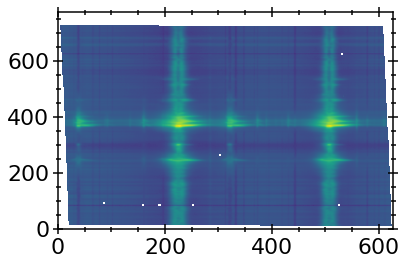

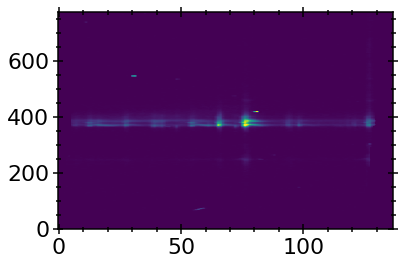

In [5]:
tind = 2300
sind = 0 ## the slit number, for sit-and-stare this is always 0
plt.imshow(sg_mgiik_dict['data'][:,tind,:,sind]**0.25,origin = 'lower',aspect='auto',
          vmin = 0)
plt.show()
tind = 2300
sind = 0 ## the slit number, for sit-and-stare this is always 0
plt.imshow(sg_oi_dict['data'][:,tind,:,sind],origin = 'lower',aspect='auto',
          vmin = 0,vmax=100)
plt.show()

> - Now, lets add wavelength to the axis

<ipython-input-6-1f7474c063fa>:3: RuntimeWarning: invalid value encountered in power
  plt.imshow(sg_mgiik_dict['data'][:,tind,:,sind]**0.25,origin = 'lower',aspect='auto',
findfont: Font family ['Avenir LT Std'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Avenir LT Std'] not found. Falling back to DejaVu Sans.


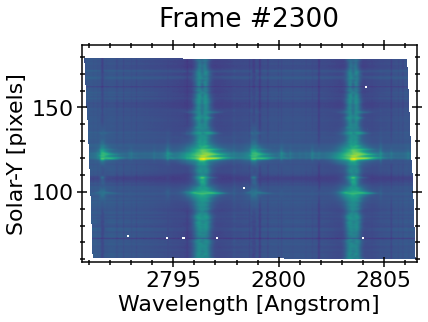

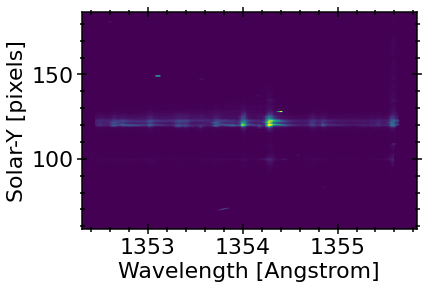

In [6]:
tind = 2300
sind = 0 ## the slit number, for sit-and-stare this is always 0
plt.imshow(sg_mgiik_dict['data'][:,tind,:,sind]**0.25,origin = 'lower',aspect='auto',
          vmin = 0,
          extent = [sg_mgiik_dict['wl'][0,0],sg_mgiik_dict['wl'][-1,0],
                    sg_mgiik_dict['slitposy'][0,0],sg_mgiik_dict['slitposy'][-1,0]])
plt.title('Frame #%d'%(tind))
plt.xlabel('Wavelength [Angstrom]')
plt.ylabel('Solar-Y [pixels]')
plt.show()
tind = 2300
sind = 0 ## the slit number, for sit-and-stare this is always 0
plt.imshow(sg_oi_dict['data'][:,tind,:,sind],origin = 'lower',aspect='auto',
          vmin = 0,vmax=100,
          extent = [sg_oi_dict['wl'][0,0],sg_oi_dict['wl'][-1,0],
                    sg_oi_dict['slitposy'][0,0],sg_oi_dict['slitposy'][-1,0]])
plt.xlabel('Wavelength [Angstrom]')
plt.ylabel('Solar-Y [pixels]')
plt.show()

> - Plot a time series

<ipython-input-7-f43a4d3c9ba4>:3: RuntimeWarning: invalid value encountered in power
  plt.imshow(sg_mgiik_dict['data'][:,tind,:,sind]**0.25,origin = 'lower',aspect='auto',


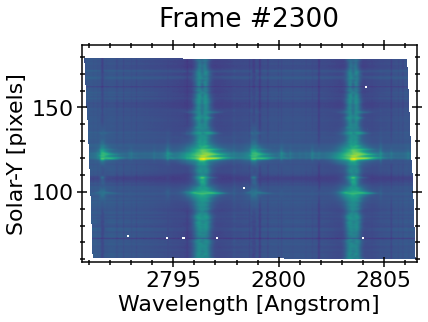

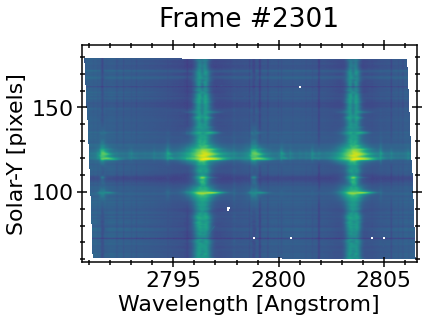

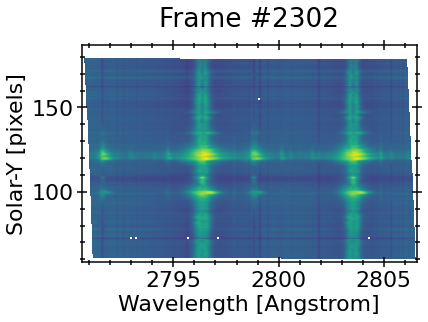

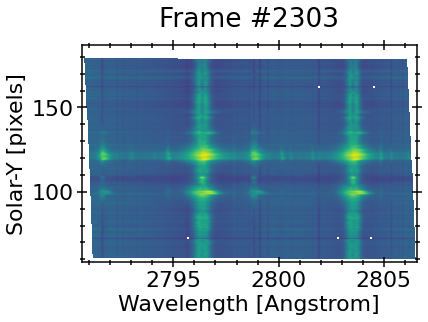

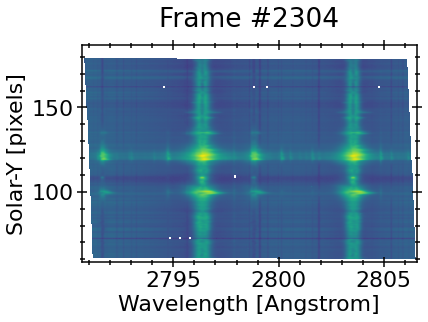

...

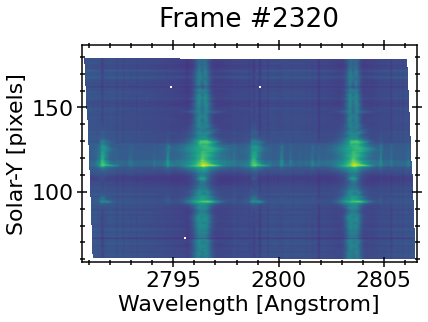

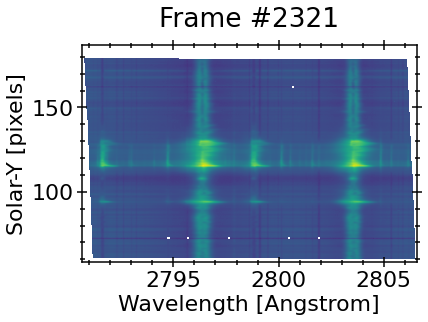

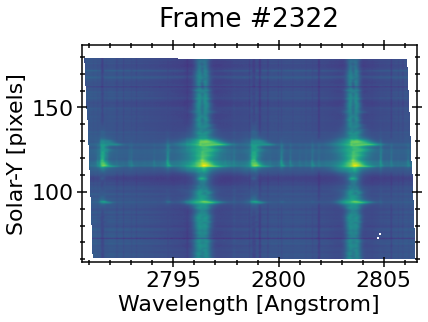

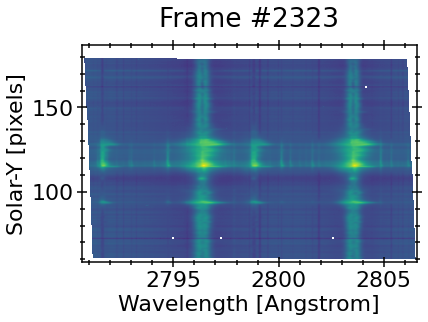

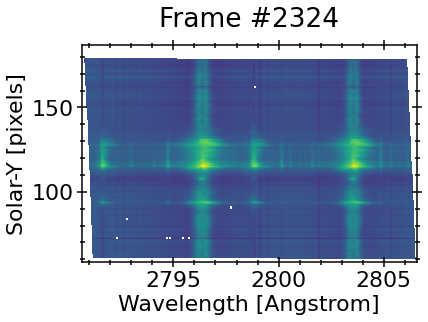

In [7]:
for tind in range(2300,2325):
    sind = 0 ## the slit number, for sit-and-stare this is always 0
    plt.imshow(sg_mgiik_dict['data'][:,tind,:,sind]**0.25,origin = 'lower',aspect='auto',
              vmin = 0,
              extent = [sg_mgiik_dict['wl'][0,0],sg_mgiik_dict['wl'][-1,0],
                        sg_mgiik_dict['slitposy'][0,0],sg_mgiik_dict['slitposy'][-1,0]])
    plt.title('Frame #%d'%(tind))
    plt.xlabel('Wavelength [Angstrom]')
    plt.ylabel('Solar-Y [pixels]')
    plt.show()
   

***Save some PNG figures, and use the ax object methods to plot***
> - I prefer using the axes methods for plotting 'good' images rather than the quick way above
> - Here we will also change the colour map
> - Note that in each frame we re-scale the colourmap to some index. How might we modify the code below to keep a consistent scaled colourmap from frame-to-frame (hint, look above for vmax)

> - Mg II NUV spectra

<ipython-input-8-49b5e465d7ad>:7: RuntimeWarning: invalid value encountered in sqrt
  data = copy.deepcopy(sg_mgiik_dict['data']**0.5)


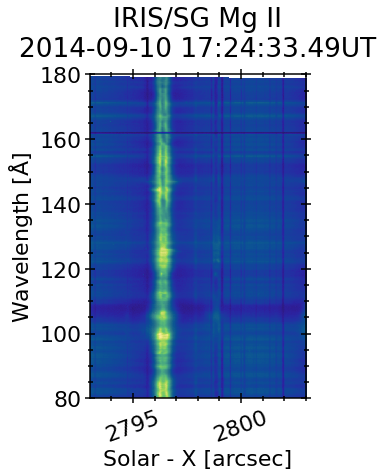

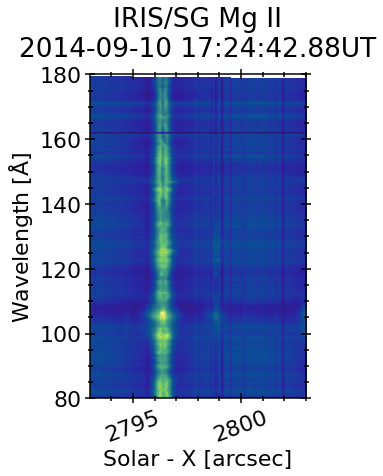

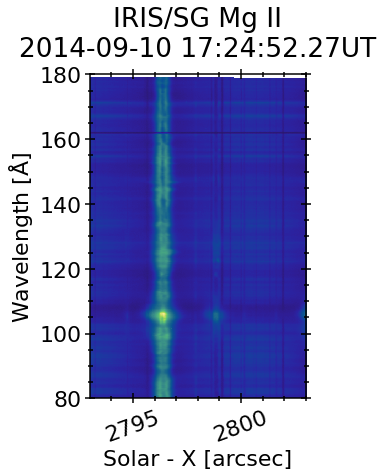

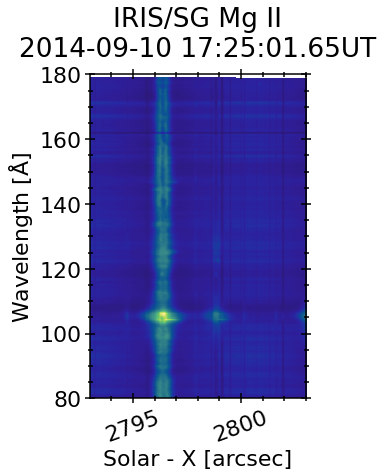

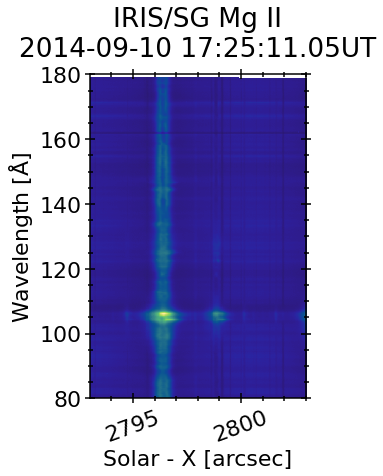

...

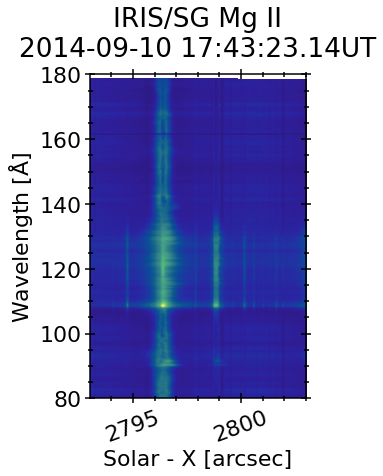

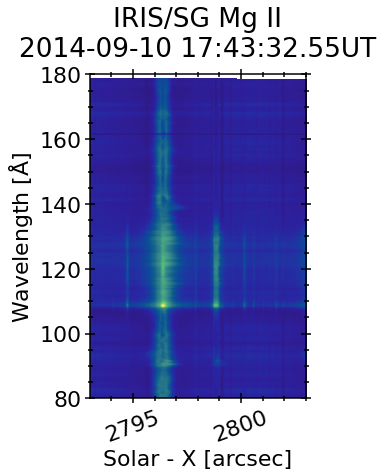

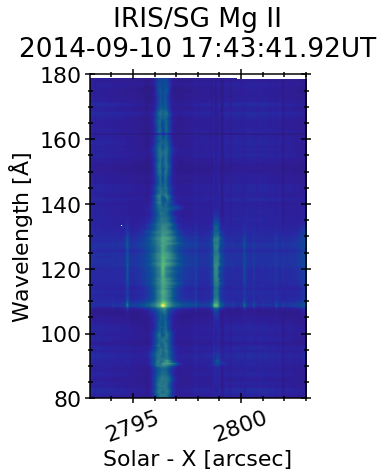

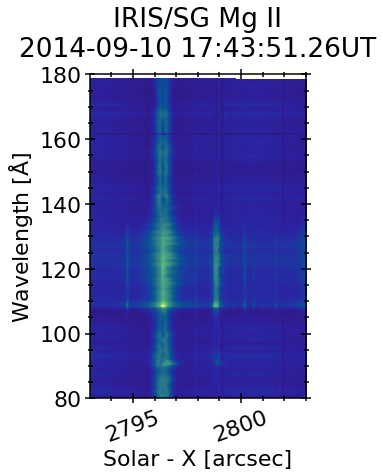

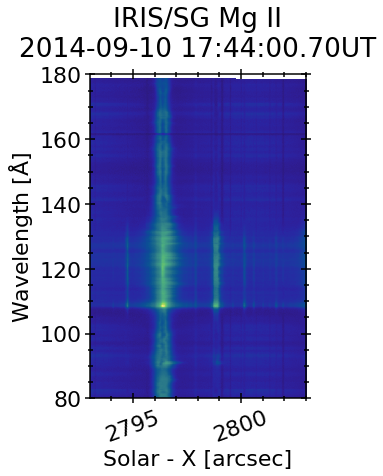

In [8]:
savepng = False

dirout = './'
fname_out = 'IRISSG_MgIIk_2014_Sept_10'

sind = 0
data = copy.deepcopy(sg_mgiik_dict['data']**0.5)

t1 = 2275
t2 = 2400

cmapmgii = cmocean.cm.haline

xrange = [2793,2803]
yrange = [80, 180]

xsel1_wl = 0
xsel2_wl = sg_mgiik_dict['wl'].shape[0]-1
ysel1_wl = 0
ysel2_wl = sg_mgiik_dict['slitposy'].shape[0]-1

# deltaxr = np.abs(xrange[0]-xrange[-1])
# deltayr = np.abs(yrange[0]-yrange[-1])

# aspect = deltaxr/deltayr

xsize = 4
ysize = 6

dx = 0.75
dy = 0.75
y1 = 0.05
x1 = 0.05
sx = 0.15


counter = 0
for tind in range(t1,t2):
    
    fig = plt.figure(figsize=(xsize, ysize))
    ax1 = fig.add_axes([x1, y1, dx, dy])

    
    ax1.set_xlim(xrange[0], xrange[-1])
    ax1.set_ylim(yrange[0], yrange[-1])

    ax1.set_ylabel('Wavelength [$\mathrm{\AA}$]')
    ax1.set_xlabel('Solar - X [arcsec]')
    ax1.xaxis.set_tick_params(rotation=20)
    ax1.tick_params(which='both', direction='inout')
    
#     ymin_sg= np.min(sg_mgiik_dict['hdr']['ycen'][tind,sind]-sg_mgiik_dict['hdr']['CDELT2'][0]*(sg_mgiik_dict['hdr']['NAXIS2']-1.e0)/2.e0)
#     ymax_sg= np.max(sg_mgiik_dict['hdr']['ycen'][tind,sind]+sg_mgiik_dict['hdr']['CDELT2'][0]*(sg_mgiik_dict['hdr']['NAXIS2']-1.e0)/2.e0)
#     ycoord_sg = np.linspace(ymin_sg,ymax_sg,num=sg_mgiik_dict['hdr']['NAXIS2'][0]) 

## here the slitposy is indexed by tind as is a sit-and-stare... if doing a rastered image then change to sind
    im = ax1.imshow(data[:,tind,:,sind],
                    cmap=cmapmgii, 
                    origin='lower',interpolation='nearest', aspect='auto',
                    extent = [sg_mgiik_dict['wl'][0,sind],sg_mgiik_dict['wl'][-1,sind],
                              sg_mgiik_dict['slitposy'][0,tind],sg_mgiik_dict['slitposy'][-1,tind]])


    ax1.set_title('IRIS/SG Mg II\n'+sg_mgiik_dict['hdr']['dateobs'][tind,sind]+'UT')

    if savepng == True:
        plt.savefig(fname_out+'_%04d.png' %(counter), format='png', bbox_inches = 'tight', dpi=300)
    
    counter+= 1
    
    plt.show()

> - ~1354A FUV spectra (Fe XXI and O I)

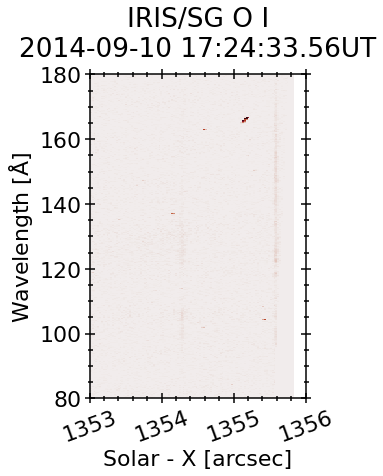

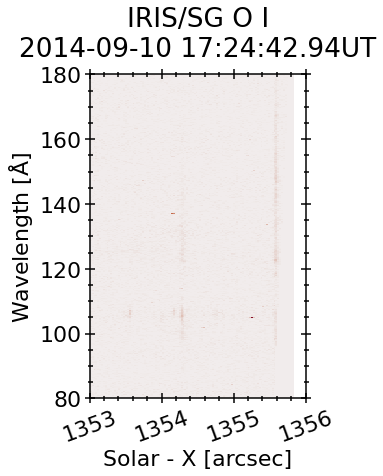

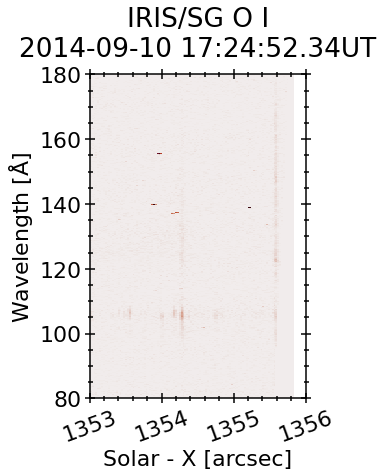

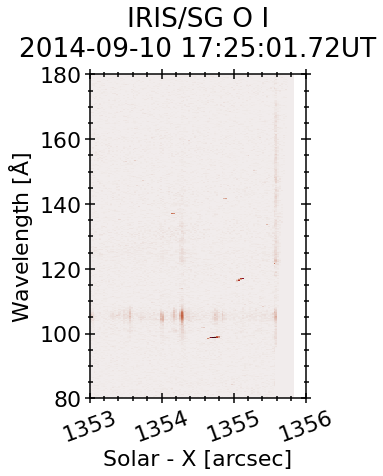

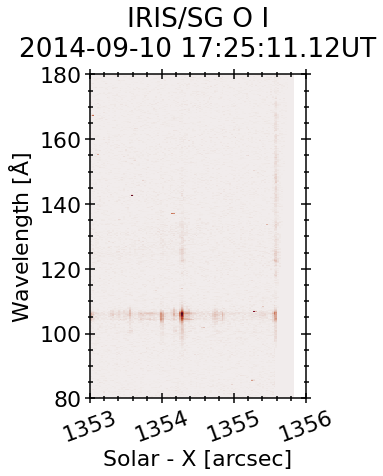

...

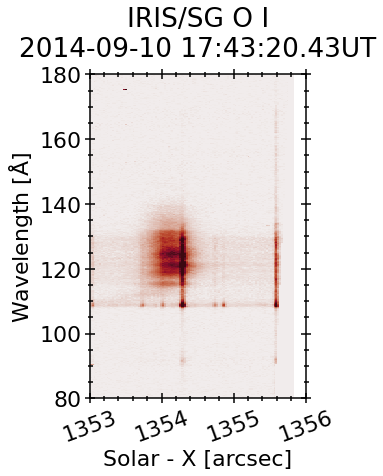

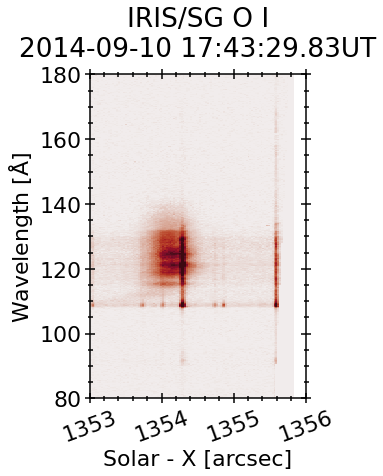

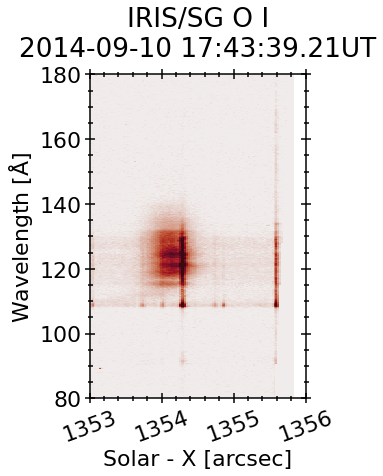

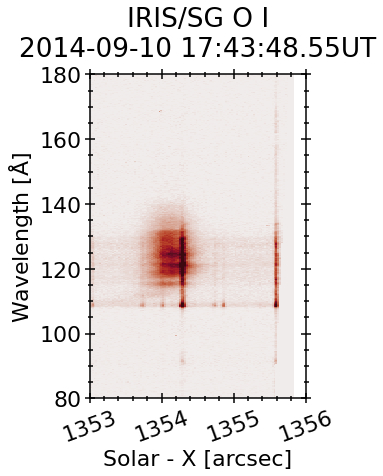

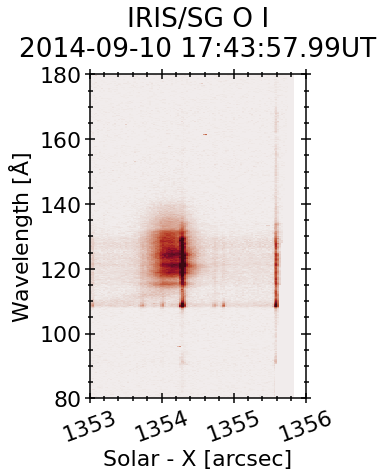

In [9]:
savepng = False

dirout = './'
fname_out = 'IRISSG_OI_2014_Sept_10'

sind = 0
data = copy.deepcopy(sg_oi_dict['data'])

t1 = 2275
t2 = 2400

cmapmgii = cmocean.cm.amp

xrange = [1353,1356]
yrange = [80, 180]

xsel1_wl = 0
xsel2_wl = sg_oi_dict['wl'].shape[0]-1
ysel1_wl = 0
ysel2_wl = sg_oi_dict['slitposy'].shape[0]-1

# deltaxr = np.abs(xrange[0]-xrange[-1])
# deltayr = np.abs(yrange[0]-yrange[-1])

# aspect = deltaxr/deltayr

xsize = 4
ysize = 6

dx = 0.75
dy = 0.75
y1 = 0.05
x1 = 0.05
sx = 0.15


counter = 0
for tind in range(t1,t2):
    
    fig = plt.figure(figsize=(xsize, ysize))
    ax1 = fig.add_axes([x1, y1, dx, dy])


    ax1.set_xlim(xrange[0], xrange[-1])
    ax1.set_ylim(yrange[0], yrange[-1])

    ax1.set_ylabel('Wavelength [$\mathrm{\AA}$]')
    ax1.set_xlabel('Solar - X [arcsec]')
    ax1.xaxis.set_tick_params(rotation=20)
    ax1.tick_params(which='both', direction='inout')
    
#     ymin_sg= np.min(sg_mgiik_dict['hdr']['ycen'][tind,sind]-sg_mgiik_dict['hdr']['CDELT2'][0]*(sg_mgiik_dict['hdr']['NAXIS2']-1.e0)/2.e0)
#     ymax_sg= np.max(sg_mgiik_dict['hdr']['ycen'][tind,sind]+sg_mgiik_dict['hdr']['CDELT2'][0]*(sg_mgiik_dict['hdr']['NAXIS2']-1.e0)/2.e0)
#     ycoord_sg = np.linspace(ymin_sg,ymax_sg,num=sg_mgiik_dict['hdr']['NAXIS2'][0]) 

    im = ax1.imshow(data[:,tind,:,sind],
                    cmap=cmapmgii, 
                    origin='lower',interpolation='nearest', aspect='auto',
                    extent = [sg_oi_dict['wl'][0,sind],sg_oi_dict['wl'][-1,sind],
                              sg_oi_dict['slitposy'][0,tind],sg_oi_dict['slitposy'][-1,tind]],
                              vmin=0,vmax=30)


    ax1.set_title('IRIS/SG O I\n'+sg_oi_dict['hdr']['dateobs'][tind,sind]+'UT')

    if savepng == True:
        plt.savefig(fname_out+'_%04d.png' %(counter), format='png', bbox_inches = 'tight', dpi=300)
    
    counter+= 1
    
    plt.show()

---
### <b style="color:blue"> Now we want to plot some individual spectra </b>



> - If you want you can load a new plotting style that removes some axes

In [10]:
plot_dict = utils.plotsetup(font_size = 22)
plt.rcParams.update(plot_dict)

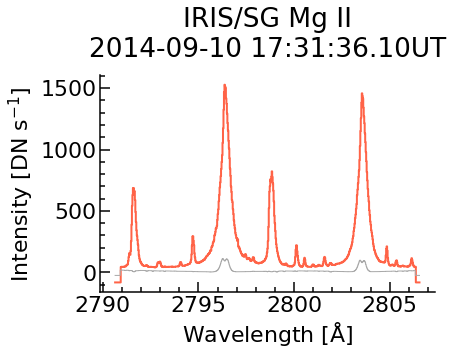

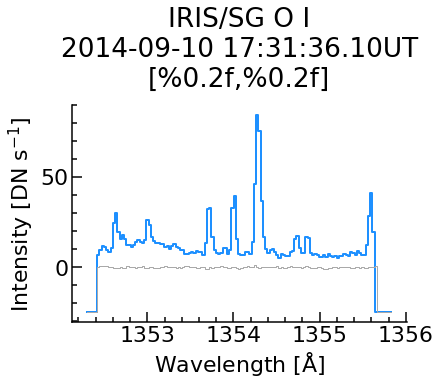

In [11]:
tind = 2320
tind_pf = 0 ## the pre-flare spectra to overlay in grey
sind = 0 ## the slit number, for sit-and-stare this is always 0
yind = 355 ## Lets look at pixel 335 along the slit
plt.plot(sg_mgiik_dict['wl'][:,sind], 
         sg_mgiik_dict['data'][yind,tind,:,sind],
         color = 'tomato',
         drawstyle = 'steps-mid',
         linewidth = 2)
plt.plot(sg_mgiik_dict['wl'][:,sind], 
         sg_mgiik_dict['data'][yind,tind_pf,:,sind],
         color = 'darkgrey',
         drawstyle = 'steps-mid',
         linewidth = 1)
plt.xlabel('Wavelength [$\mathrm{\AA}$]')
plt.ylabel('Intensity [DN s$^{-1}$]')
plt.title('IRIS/SG Mg II\n'+sg_oi_dict['hdr']['dateobs'][tind,sind]+'UT')
plt.show()

plt.plot(sg_oi_dict['wl'][:,sind], 
         sg_oi_dict['data'][yind,tind,:,sind],
         color = 'dodgerblue',
         drawstyle = 'steps-mid',
         linewidth = 2)
plt.plot(sg_oi_dict['wl'][:,sind], 
         sg_oi_dict['data'][yind,tind_pf,:,sind],
         color = 'darkgrey',
         drawstyle = 'steps-mid',
         linewidth = 1)
plt.xlabel('Wavelength [$\mathrm{\AA}$]')
plt.ylabel('Intensity [DN s$^{-1}$]')
plt.title('IRIS/SG O I\n'+sg_oi_dict['hdr']['dateobs'][tind,sind]+'UT\n[%0.2f,%0.2f]')
plt.show()